In [ ]:
import numpy as np 
import pandas as pd 
import os
import torch
import torchvision
from glob import glob
import torch.nn as nn
from tqdm import tqdm
import matplotlib.pyplot as plt
import torch.nn.functional as F
import torchvision.transforms as transform
from torch.utils.data import DataLoader,Dataset
from torch.utils.tensorboard import SummaryWriter
from torchvision.utils import make_grid

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!cp /content/drive/MyDrive/archive.zip -d /content/archive.zip

In [ ]:
!unzip /content/archive.zip

Streaming output truncated to the last 5000 lines.
  inflating: cityscapes_data/cityscapes_data/train/2754.jpg  
  inflating: cityscapes_data/cityscapes_data/train/2755.jpg  
  inflating: cityscapes_data/cityscapes_data/train/2756.jpg  
  inflating: cityscapes_data/cityscapes_data/train/2757.jpg  
  inflating: cityscapes_data/cityscapes_data/train/2758.jpg  
  inflating: cityscapes_data/cityscapes_data/train/2759.jpg  
  inflating: cityscapes_data/cityscapes_data/train/276.jpg  
  inflating: cityscapes_data/cityscapes_data/train/2760.jpg  
  inflating: cityscapes_data/cityscapes_data/train/2761.jpg  
  inflating: cityscapes_data/cityscapes_data/train/2762.jpg  
  inflating: cityscapes_data/cityscapes_data/train/2763.jpg  
  inflating: cityscapes_data/cityscapes_data/train/2764.jpg  
  inflating: cityscapes_data/cityscapes_data/train/2765.jpg  
  inflating: cityscapes_data/cityscapes_data/train/2766.jpg  
  inflating: cityscapes_data/cityscapes_data/train/2767.jpg  
  inflating: citysca

In [ ]:
!cp /content/drive/MyDrive/modelDumps/RESNETNET50withUNET.zip -d /content/RESNETNET50withUNET.zip

In [ ]:
!unzip /content/RESNETNET50withUNET.zip

Archive:  /content/RESNETNET50withUNET.zip
  inflating: RESNETNET50withUNET.pth  


In [ ]:
train_path = glob('/content/cityscapes_data/train/*')
valid_path = glob('/content/cityscapes_data/val/*')

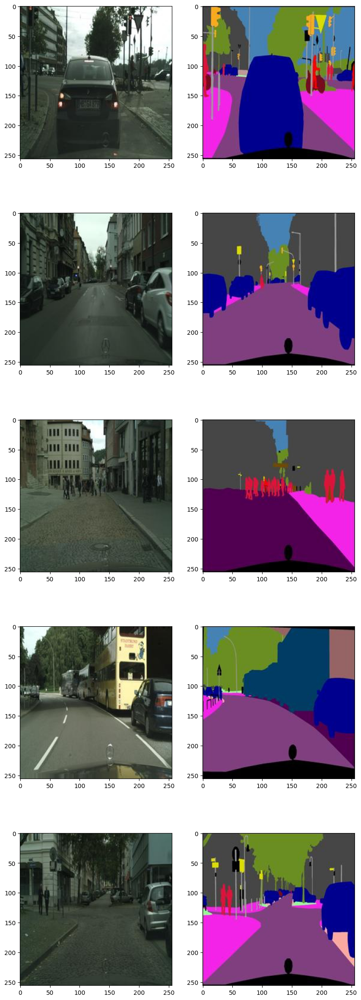

In [ ]:
fig,ax = plt.subplots(5,2,figsize=(10,30))
for i in range(5):
    img = plt.imread(train_path[i])
    ax[i][0].imshow(img[:,:256])
    ax[i][1].imshow(img[:,256:])

In [ ]:
train_dataset = []
validation_dataset = []

In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [ ]:
class MyDataset(Dataset):
    def __init__(self, images_path ,transform_img ,transform_label):
        
        self.images_path = images_path
        self.transform_img = transform_img
        self.transform_label = transform_label
    def __len__(self):
        return len(self.images_path)
    def __getitem__(self, idx):  
        img = plt.imread(self.images_path[idx])
        image,label = img[:,:int(img.shape[1]/2)],img[:,int(img.shape[1]/2):]
        if self.transform_img:
            image = self.transform_img(image)      
        if self.transform_label:
            label = self.transform_label(label)       
        return image, label

In [ ]:
mytransformsImage = transform.Compose([   
        transform.ToTensor(),
        transform.Resize((256*2,256*2)),])
mytransformsLabel = transform.Compose([
        transform.ToTensor(),
        transform.Resize((256*2,256*2)),])

In [ ]:
traindata = MyDataset(train_path,transform_img= mytransformsImage,transform_label= mytransformsLabel)

In [ ]:
valdata = MyDataset(valid_path, mytransformsImage, mytransformsLabel)

In [ ]:
batch_size = 4
train_loader = DataLoader(traindata,batch_size)
val_loader = DataLoader(valdata,4)

In [ ]:
for i,j in train_loader:
  break

/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


In [ ]:
def show(img,output,label,denorm = False):
    img,output,label = img.cpu(),output.cpu(),label.cpu()
    fig,ax = plt.subplots(len(output),3,figsize=(10,10))
    
    for i in range(len(output)):
        if(len(output) == 3):
            Img,Lab,act = img[i],output[i],label[i]
            Img,Lab,act = Img,Lab.detach().permute(1,2,0).numpy(),act
            ax[i][0].imshow(Img.permute(1,2,0))
            ax[i][1].imshow(Lab)
            ax[i][2].imshow(act.permute(1,2,0))
        else:
            Img,Lab,act = img[i],output[i],label[i]
            Img,Lab,act = Img,Lab.detach().permute(1,2,0).numpy(),act
            ax[0].imshow(Img.permute(1,2,0))
            ax[1].imshow(Lab)
            ax[2].imshow(act.permute(1,2,0))
    plt.show()

In [ ]:
class Convblock(nn.Module): 
      def __init__(self,input_channel,output_channel,kernal=3,stride=1,padding=1):     
        super().__init__()
        self.convblock = nn.Sequential(
            nn.Conv2d(input_channel,output_channel,kernal,stride,padding),
            nn.BatchNorm2d(output_channel),
            nn.ReLU(inplace=True),
            nn.Conv2d(output_channel,output_channel,kernal),
            nn.ReLU(inplace=True),
        )
      def forward(self,x):
        x = self.convblock(x)
        return x

In [ ]:
# Encoder -> BottelNeck => Decoder
class UNet(nn.Module):
    
    def __init__(self,input_channel,retain=True):

        super().__init__()

        self.conv1 = Convblock(input_channel,32)
        self.conv2 = Convblock(32,64)
        self.conv3 = Convblock(64,128)
        self.conv4 = Convblock(128,256)
        self.neck = nn.Conv2d(256,512,3,1)
        self.upconv4 = nn.ConvTranspose2d(512,256,3,2,0,1)
        self.dconv4 = Convblock(512,256)
        self.upconv3 = nn.ConvTranspose2d(256,128,3,2,0,1)
        self.dconv3 = Convblock(256,128)
        self.upconv2 = nn.ConvTranspose2d(128,64,3,2,0,1)
        self.dconv2 = Convblock(128,64)
        self.upconv1 = nn.ConvTranspose2d(64,32,3,2,0,1)
        self.dconv1 = Convblock(64,32)
        self.out = nn.Conv2d(32,3,1,1)
        self.retain = retain
        
    def forward(self,x):
        conv1 = self.conv1(x)
        pool1 = F.max_pool2d(conv1,kernel_size=2,stride=2)
        conv2 = self.conv2(pool1)
        pool2 = F.max_pool2d(conv2,kernel_size=2,stride=2)
        conv3 = self.conv3(pool2)
        pool3 = F.max_pool2d(conv3,kernel_size=2,stride=2)
        conv4 = self.conv4(pool3)
        pool4 = F.max_pool2d(conv4,kernel_size=2,stride=2)
        neck = self.neck(pool4)
        upconv4 = self.upconv4(neck)
        croped = self.crop(conv4,upconv4)
        dconv4 = self.dconv4(torch.cat([upconv4,croped],1))
        upconv3 = self.upconv3(dconv4)
        croped = self.crop(conv3,upconv3)
        dconv3 = self.dconv3(torch.cat([upconv3,croped],1))
        upconv2 = self.upconv2(dconv3)
        croped = self.crop(conv2,upconv2)
        dconv2 = self.dconv2(torch.cat([upconv2,croped],1))
        upconv1 = self.upconv1(dconv2)
        croped = self.crop(conv1,upconv1)
        dconv1 = self.dconv1(torch.cat([upconv1,croped],1))
        out = self.out(dconv1)
        if self.retain == True:
            out = F.interpolate(out,list(x.shape)[2:])
        return out
    def crop(self,input_tensor,target_tensor):
        _,_,H,W = target_tensor.shape
        return transform.CenterCrop([H,W])(input_tensor)

In [ ]:
model = UNet(3).float().to(device)
lr = 0.01
epochs = 50

In [ ]:
lossfunc = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=lr)

In [ ]:
train_acc = []
val_acc = []
train_loss = []
val_loss = []

  0%|                                                                                          | 0/744 [00:00<?, ?it/s]C:\Users\PUPLU\AppData\Local\Programs\Python\Python310\lib\site-packages\torchvision\transforms\functional.py:152: UserWarning: The given NumPy array is not writable, and PyTorch does not support non-writable tensors. This means writing to this tensor will result in undefined behavior. You may want to copy the array to protect its data or make it writable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at ..\torch\csrc\utils\tensor_numpy.cpp:212.)
  img = torch.from_numpy(pic.transpose((2, 0, 1))).contiguous()
100%|████████████████████████████████████████████████████████████████████████████████| 744/744 [01:10<00:00, 10.58it/s]


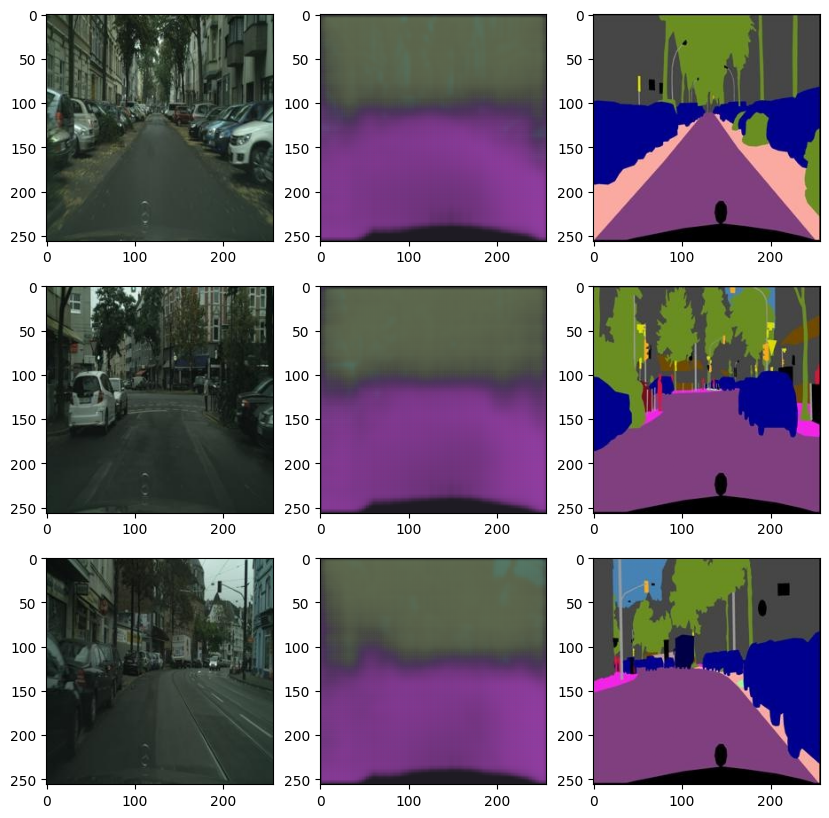

100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 101.90it/s]


epoch : 0 ,train loss : 0.0357654251543785 ,valid loss : 0.03192512863315642 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 106.21it/s]


epoch : 1 ,train loss : 0.030536621285762677 ,valid loss : 0.0313635918609798 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 100.07it/s]


epoch : 2 ,train loss : 0.029777854936377655 ,valid loss : 0.030733659693971276 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 109.87it/s]


epoch : 3 ,train loss : 0.029332304419699296 ,valid loss : 0.03072523213736713 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 103.05it/s]


epoch : 4 ,train loss : 0.02896286195810003 ,valid loss : 0.03042783077061176 


100%|████████████████████████████████████████████████████████████████████████████████| 744/744 [01:04<00:00, 11.52it/s]


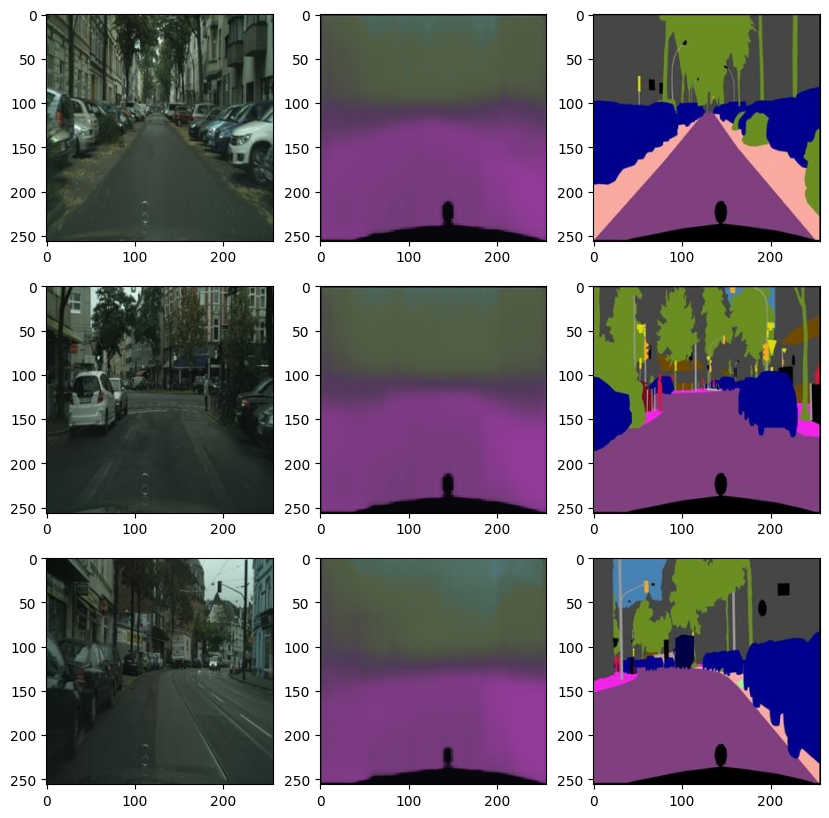

100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 104.54it/s]


epoch : 5 ,train loss : 0.02862884298402576 ,valid loss : 0.030148591561242936 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 105.03it/s]


epoch : 6 ,train loss : 0.028374721934538213 ,valid loss : 0.030105216335505246 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 104.98it/s]


epoch : 7 ,train loss : 0.02824894901144729 ,valid loss : 0.029819006063044072 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 105.04it/s]


epoch : 8 ,train loss : 0.02798473749620219 ,valid loss : 0.02952095347456634 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 105.60it/s]


epoch : 9 ,train loss : 0.02788095363611055 ,valid loss : 0.029297179128974678 


100%|████████████████████████████████████████████████████████████████████████████████| 744/744 [01:03<00:00, 11.66it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


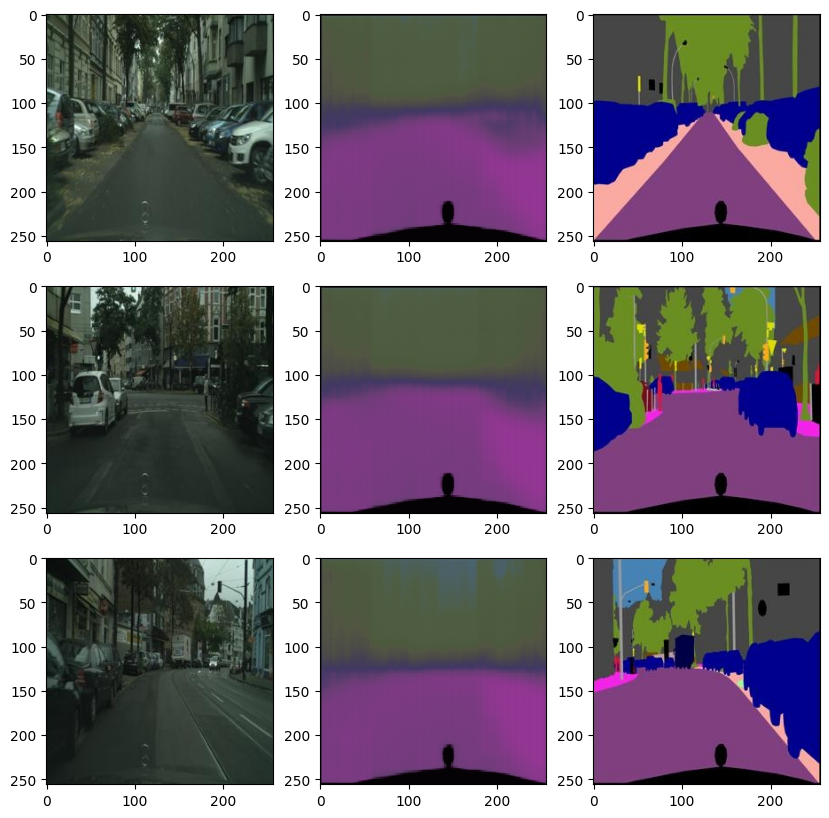

100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 103.53it/s]


epoch : 10 ,train loss : 0.027733510479040605 ,valid loss : 0.029053314812481402 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 104.03it/s]


epoch : 11 ,train loss : 0.027708437184863273 ,valid loss : 0.029015966335311533 


100%|████████████████████████████████████████████████████████████████████████████████| 500/500 [00:05<00:00, 99.31it/s]


epoch : 12 ,train loss : 0.027476518855540342 ,valid loss : 0.028623968871310353 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 106.24it/s]


epoch : 13 ,train loss : 0.027391368337976996 ,valid loss : 0.028375190801918505 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 104.50it/s]


epoch : 14 ,train loss : 0.02724111191077178 ,valid loss : 0.028468329459428787 


100%|████████████████████████████████████████████████████████████████████████████████| 744/744 [01:03<00:00, 11.64it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


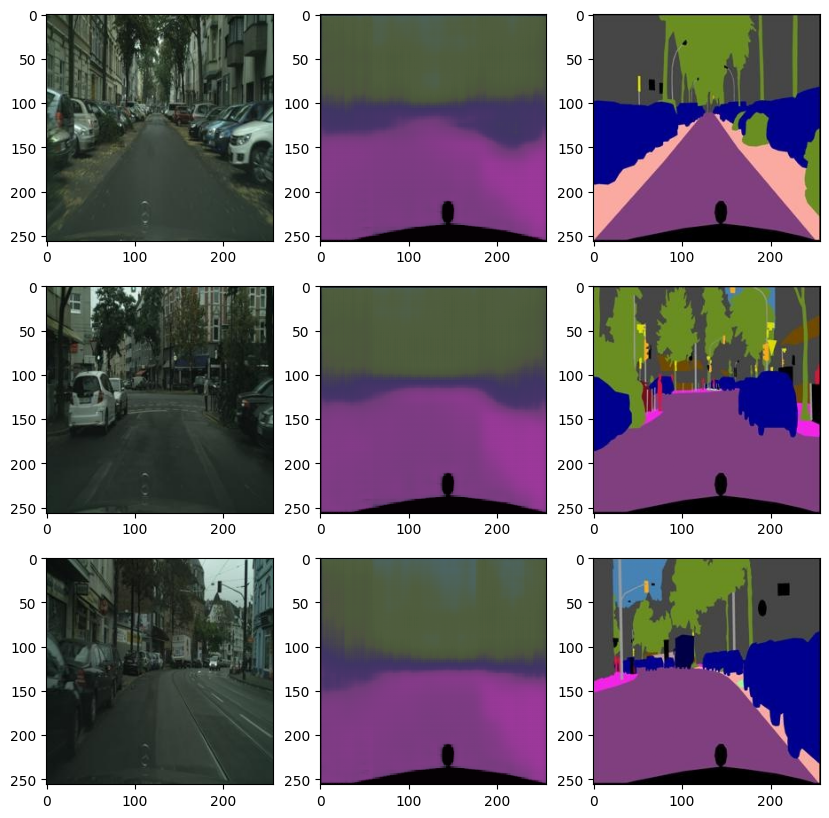

100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 105.52it/s]


epoch : 15 ,train loss : 0.027164664717831757 ,valid loss : 0.028317463802173735 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 104.30it/s]


epoch : 16 ,train loss : 0.027028519647716676 ,valid loss : 0.02806046398356557 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 105.45it/s]


epoch : 17 ,train loss : 0.026887995707902616 ,valid loss : 0.02772931599803269 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 105.24it/s]


epoch : 18 ,train loss : 0.026796863379297396 ,valid loss : 0.02775656108558178 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 105.50it/s]


epoch : 19 ,train loss : 0.026687704539927904 ,valid loss : 0.02750265647470951 


100%|████████████████████████████████████████████████████████████████████████████████| 744/744 [01:04<00:00, 11.60it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


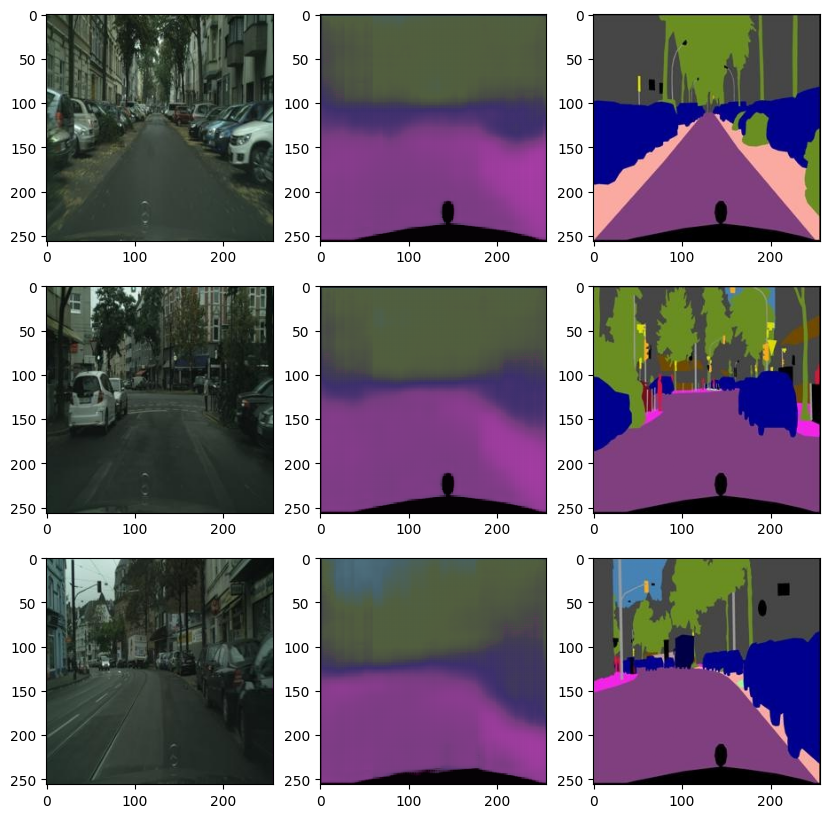

100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 102.67it/s]


epoch : 20 ,train loss : 0.02653044783785659 ,valid loss : 0.02779138200543821 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 101.59it/s]


epoch : 21 ,train loss : 0.02636112844551443 ,valid loss : 0.027979691276326775 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 104.96it/s]


epoch : 22 ,train loss : 0.026181509924842226 ,valid loss : 0.02717818209528923 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 107.38it/s]


epoch : 23 ,train loss : 0.026019612724031572 ,valid loss : 0.02765304206684232 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 106.48it/s]


epoch : 24 ,train loss : 0.02577524946036158 ,valid loss : 0.02745244899392128 


100%|████████████████████████████████████████████████████████████████████████████████| 744/744 [01:03<00:00, 11.66it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


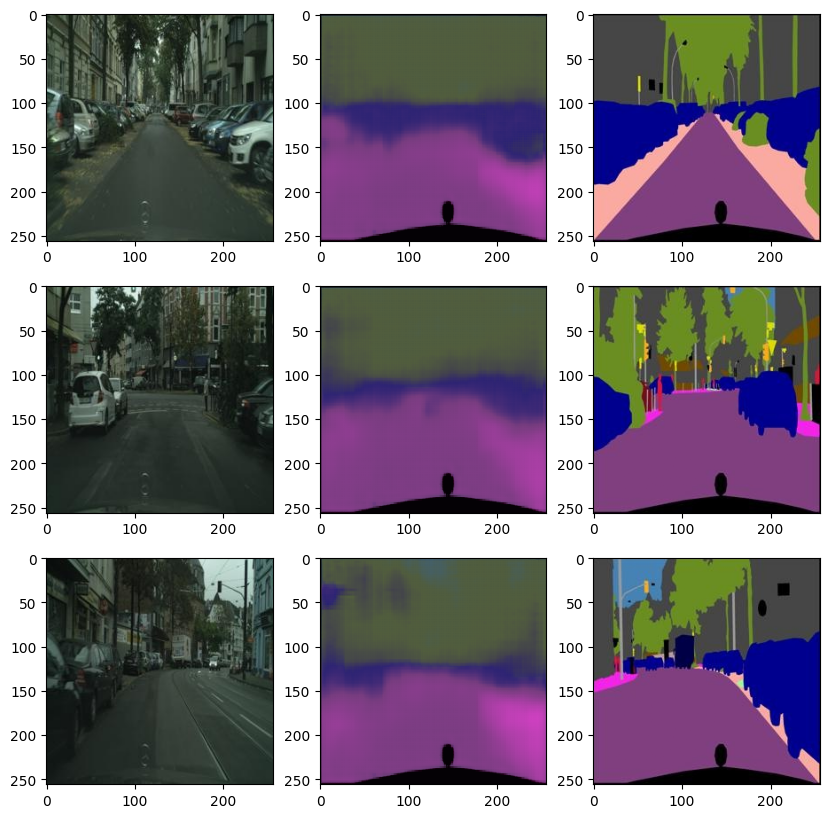

100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 108.55it/s]


epoch : 25 ,train loss : 0.0254840514727778 ,valid loss : 0.027842193774878978 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 103.19it/s]


epoch : 26 ,train loss : 0.02515149647144661 ,valid loss : 0.027926286006346345 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 102.90it/s]


epoch : 27 ,train loss : 0.024806139576348966 ,valid loss : 0.027904279947280883 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 106.46it/s]


epoch : 28 ,train loss : 0.024415875598537907 ,valid loss : 0.027959707682952285 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 103.01it/s]


epoch : 29 ,train loss : 0.024112678173008145 ,valid loss : 0.028141711765900253 


100%|████████████████████████████████████████████████████████████████████████████████| 744/744 [01:03<00:00, 11.72it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


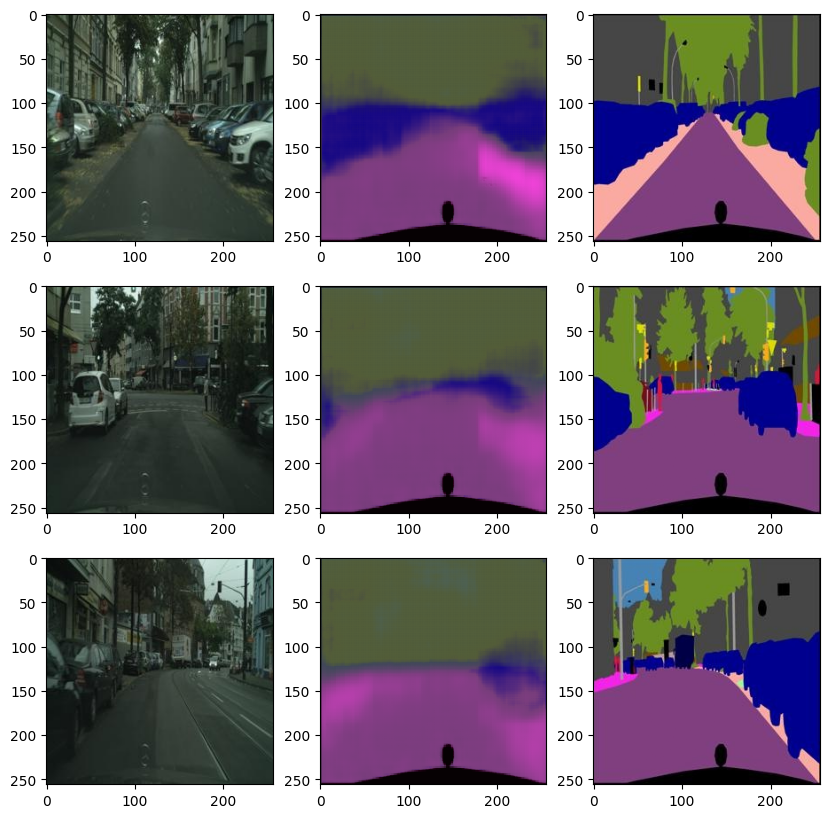

100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 106.13it/s]


epoch : 30 ,train loss : 0.023681936959575822 ,valid loss : 0.027551030034199356 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 104.34it/s]


epoch : 31 ,train loss : 0.02333126578515055 ,valid loss : 0.027635800627991557 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 104.52it/s]


epoch : 32 ,train loss : 0.0229402966396783 ,valid loss : 0.027552922002971172 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 109.55it/s]


epoch : 33 ,train loss : 0.02256547828124816 ,valid loss : 0.027939228314906358 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 110.39it/s]


epoch : 34 ,train loss : 0.022330472757789478 ,valid loss : 0.027289139866828918 


100%|████████████████████████████████████████████████████████████████████████████████| 744/744 [01:03<00:00, 11.66it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


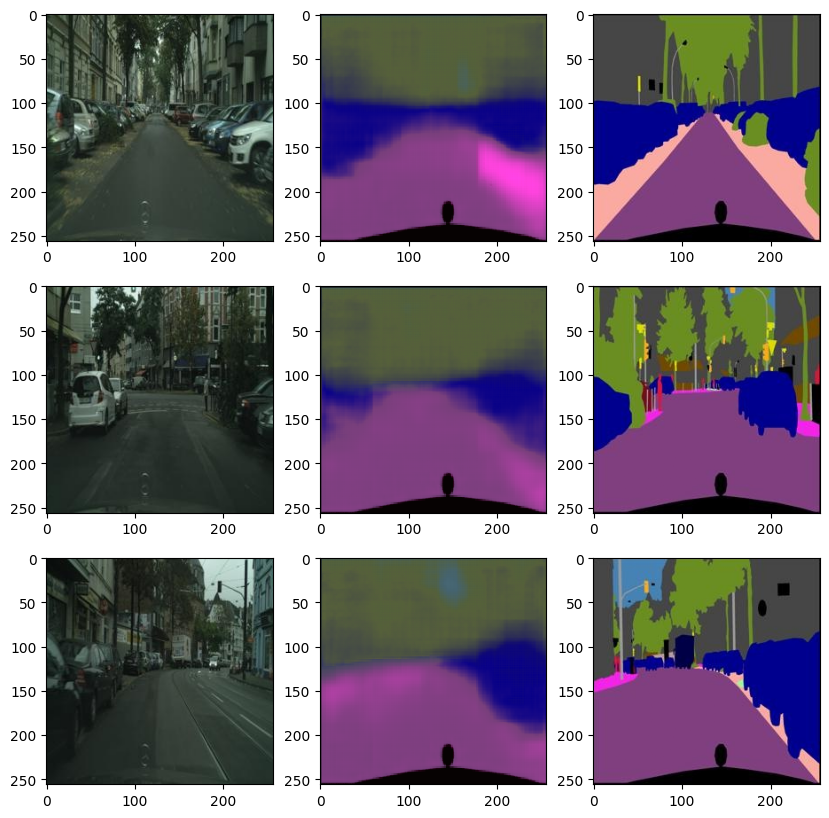

100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 101.99it/s]


epoch : 35 ,train loss : 0.02209961306183569 ,valid loss : 0.027500101462006567 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 105.91it/s]


epoch : 36 ,train loss : 0.02185924281616525 ,valid loss : 0.027811108032241464 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 106.91it/s]


epoch : 37 ,train loss : 0.02166662951781144 ,valid loss : 0.027618194235488773 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 107.02it/s]


epoch : 38 ,train loss : 0.02140905542339208 ,valid loss : 0.027291491232812406 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 106.47it/s]


epoch : 39 ,train loss : 0.021176718181670114 ,valid loss : 0.028311669427901507 


100%|████████████████████████████████████████████████████████████████████████████████| 744/744 [01:03<00:00, 11.68it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


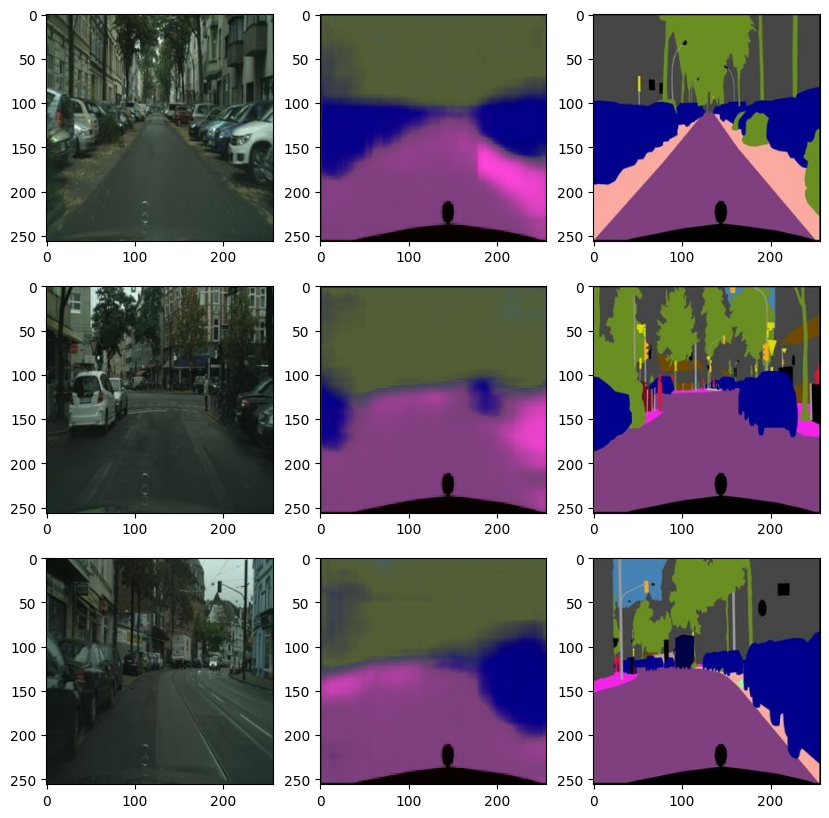

100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 104.21it/s]


epoch : 40 ,train loss : 0.02090450600215224 ,valid loss : 0.027970448434352875 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 105.07it/s]


epoch : 41 ,train loss : 0.02063141934829013 ,valid loss : 0.02775874306075275 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 107.14it/s]


epoch : 42 ,train loss : 0.020556833736488336 ,valid loss : 0.02758285503461957 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 104.49it/s]


epoch : 43 ,train loss : 0.020350467423678086 ,valid loss : 0.027939138712361453 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 103.63it/s]


epoch : 44 ,train loss : 0.020097319322127487 ,valid loss : 0.028042220927774905 


100%|████████████████████████████████████████████████████████████████████████████████| 744/744 [01:03<00:00, 11.65it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


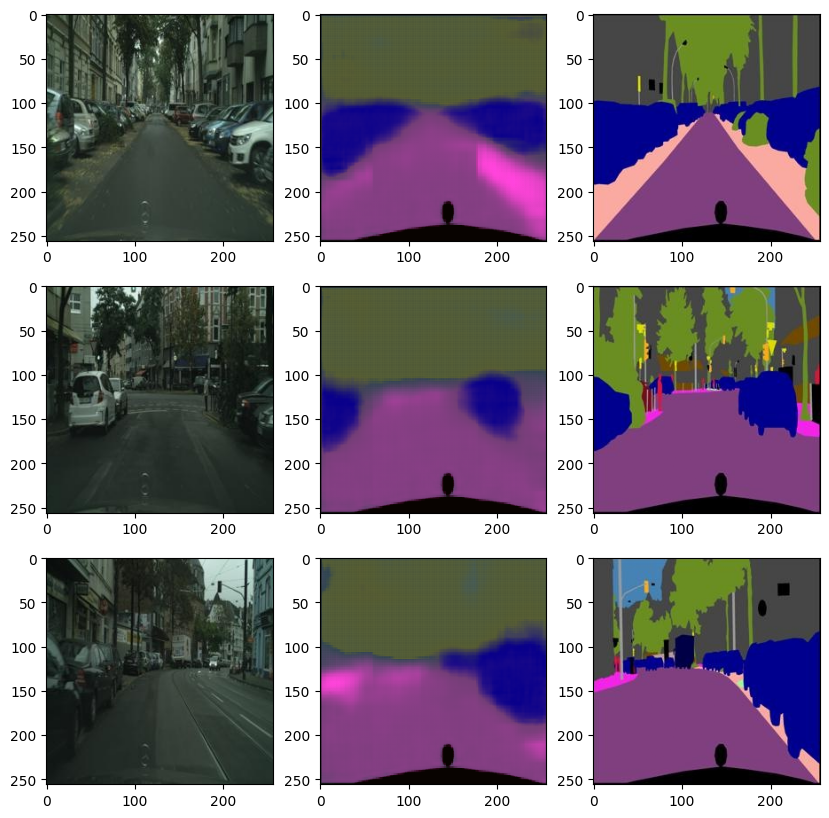

100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 104.99it/s]


epoch : 45 ,train loss : 0.019846701634026343 ,valid loss : 0.027689912119880318 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 110.49it/s]


epoch : 46 ,train loss : 0.01965568354228131 ,valid loss : 0.027901328194886447 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 103.59it/s]


epoch : 47 ,train loss : 0.019484817568633343 ,valid loss : 0.02792726785503328 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 104.96it/s]


epoch : 48 ,train loss : 0.019228978602025378 ,valid loss : 0.027172224260866643 


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:04<00:00, 109.70it/s]

epoch : 49 ,train loss : 0.01902542105920973 ,valid loss : 0.028321285201236605 


In [ ]:
for i in range(epochs): 
    trainloss = 0
    valloss = 0
    for img,label in tqdm(train_loader):
        optimizer.zero_grad()
        img = img.to(device)
        label = label.to(device)
        #print(img.shape)
        #print(label.shape)
        output = model(img)
        loss = lossfunc(output,label)
        loss.backward()
        optimizer.step()
        trainloss+=loss.item()
    if(i%5==0):
        show(img,output,label)
    train_loss.append(trainloss/len(train_loader))    
    for img,label in tqdm(val_loader):
        img = img.to(device)
        label = label.to(device)
        output = model(img)
        loss = lossfunc(output,label)
        valloss+=loss.item()
    val_loss.append(valloss/len(val_loader))  
    print("epoch : {} ,train loss : {} ,valid loss : {} ".format(i,train_loss[-1],val_loss[-1]))

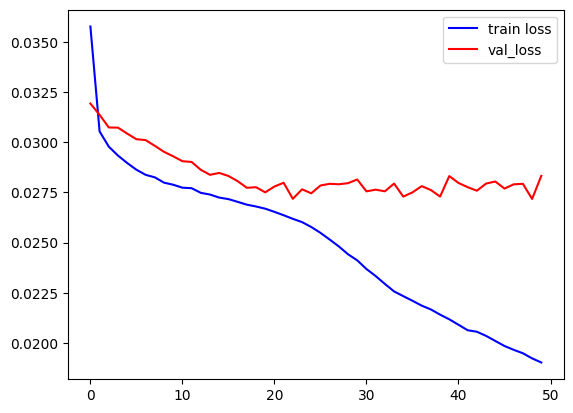

In [ ]:
plt.plot(train_loss,color='b',label='train loss')
plt.plot(val_loss,color='r',label = 'val_loss')
plt.legend()

In [ ]:
def show(img,output,label,denorm = False):
    img,output,label = img.cpu(),output.cpu(),label.cpu()
    fig,ax = plt.subplots(len(output),3,figsize=(15,30))
    cols = ['Input Image','Actual Output','Predicted Output']
    for i in range(len(output)):
        if(len(output) == 3):
            Img,Lab,act = img[i],output[i],label[i]
            Img,Lab,act = Img,Lab.detach().permute(1,2,0).numpy(),act
            ax[i][0].imshow(Img.permute(1,2,0))
            ax[i][2].imshow(Lab)
            ax[i][1].imshow(act.permute(1,2,0))
        else:
            Img,Lab,act = img[i],output[i],label[i]
            Img,Lab,act = Img,Lab.detach().permute(1,2,0).numpy(),act
            ax[0].imshow(Img.permute(1,2,0))
            ax[2].imshow(Lab)
            ax[1].imshow(act.permute(1,2,0))
            #ax[0].title('this')
            for ax, col in zip(ax, cols):
                ax.set_title(col)
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


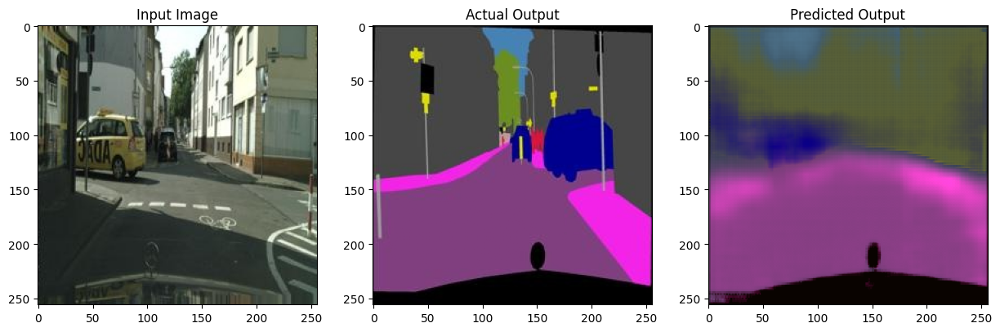

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


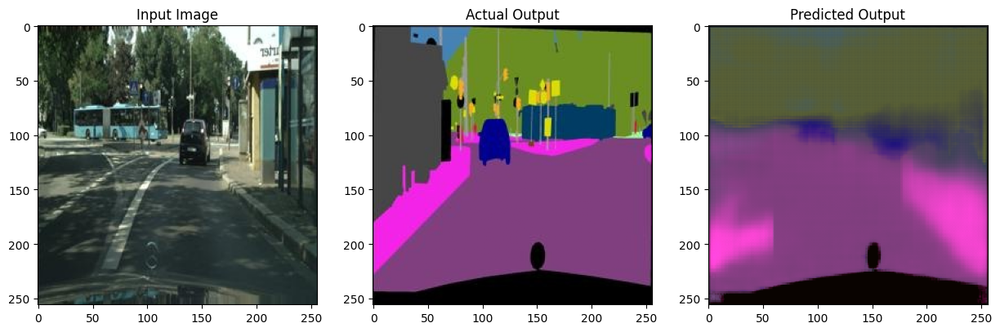

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


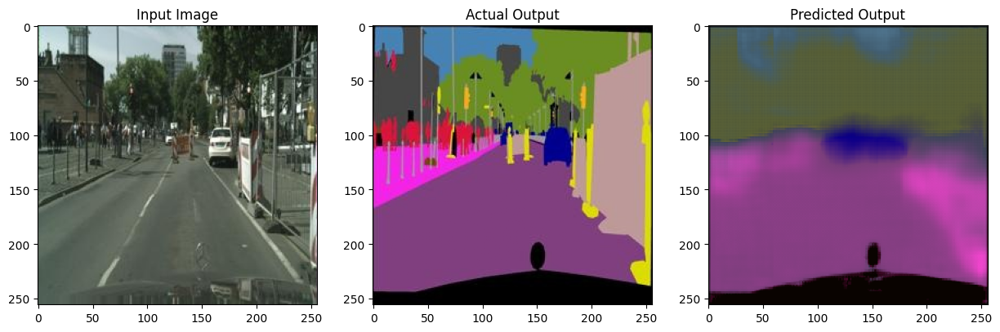

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


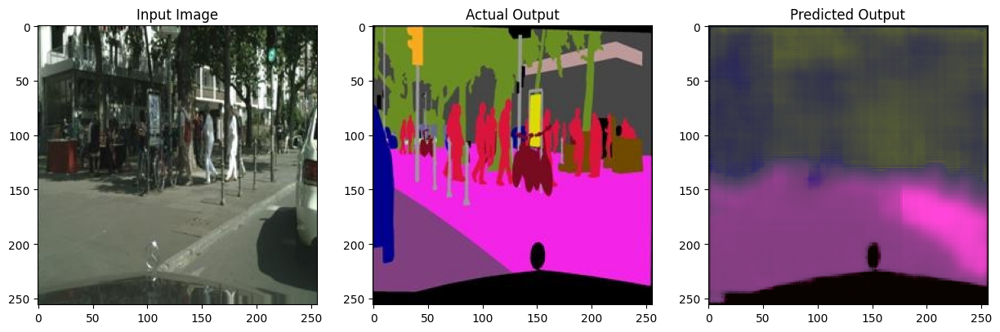

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


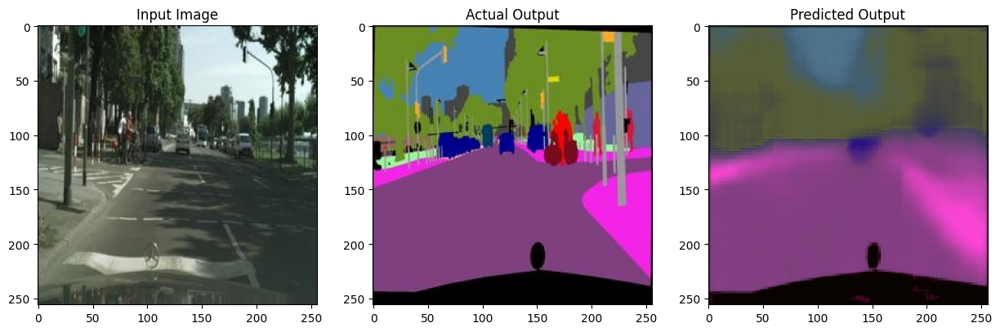

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


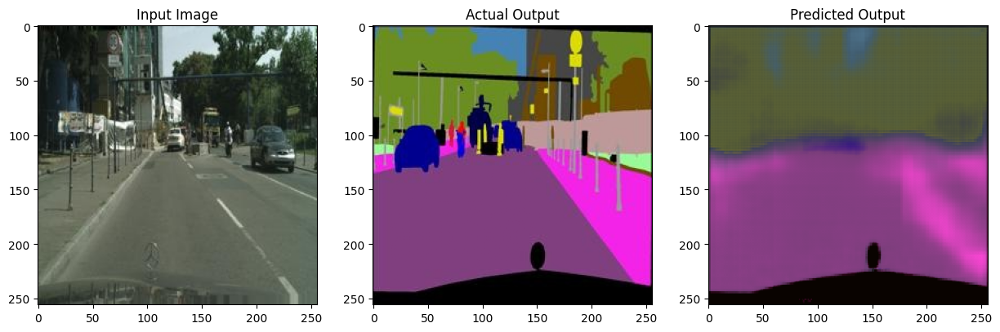

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


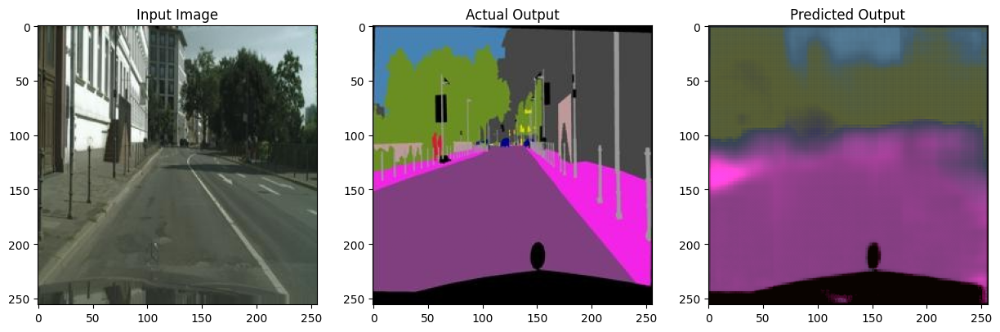

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


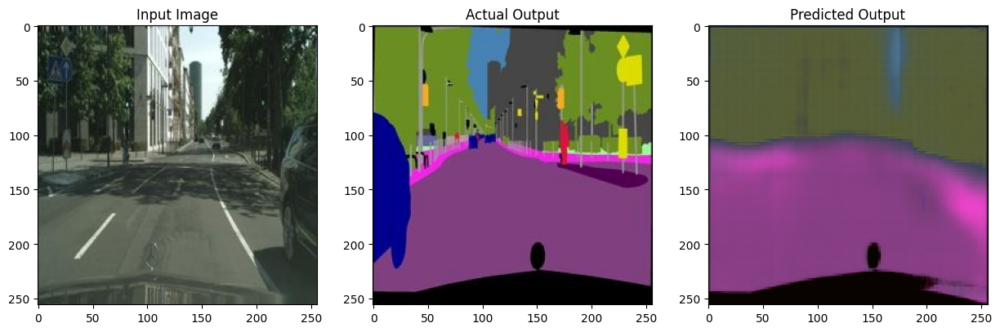

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


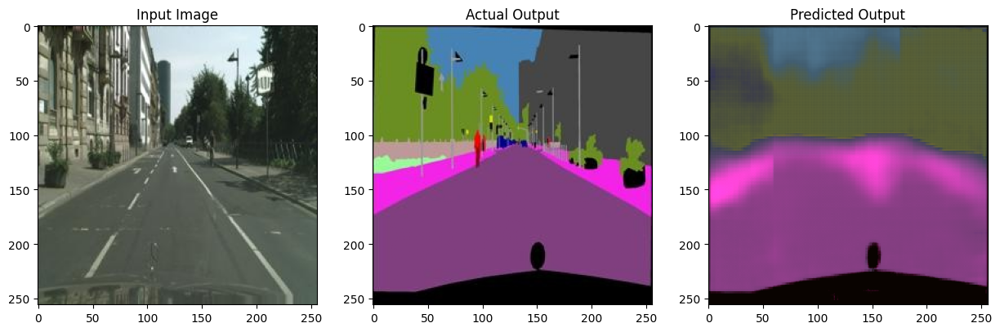

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


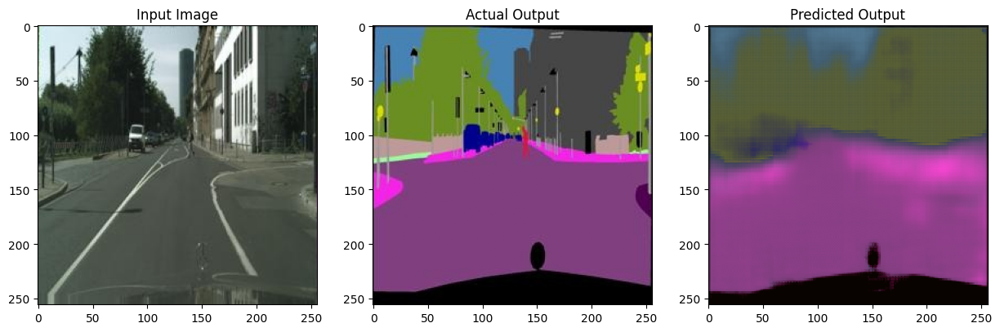

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


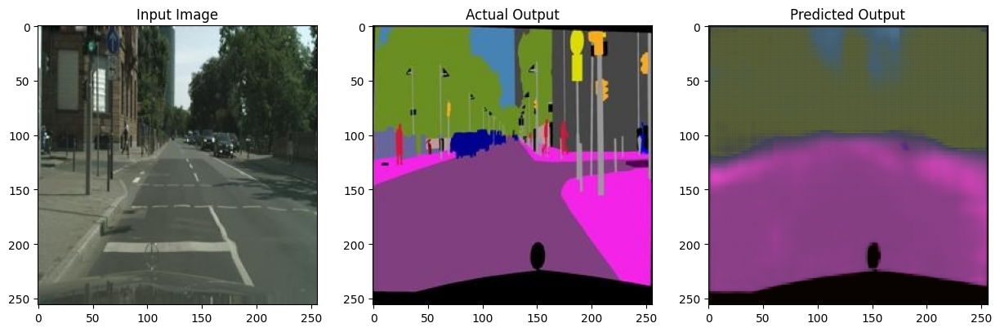

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


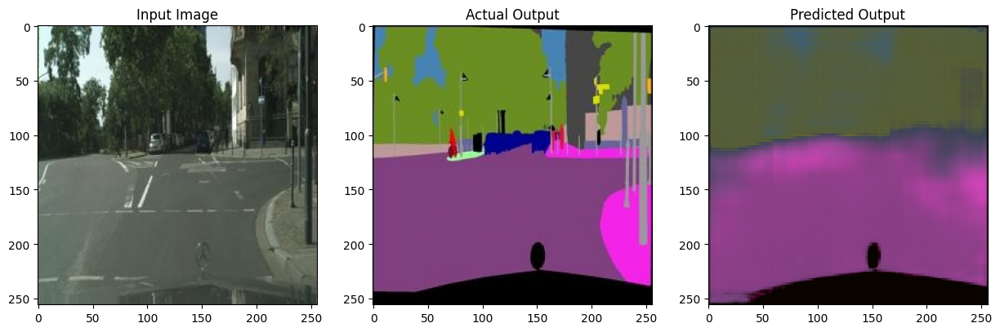

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


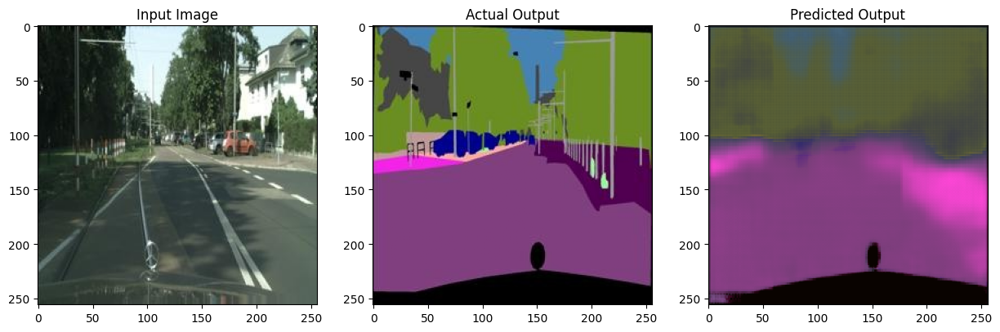

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


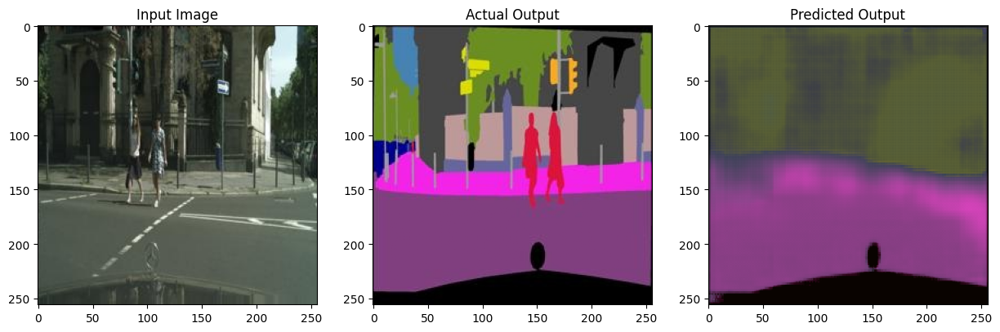

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


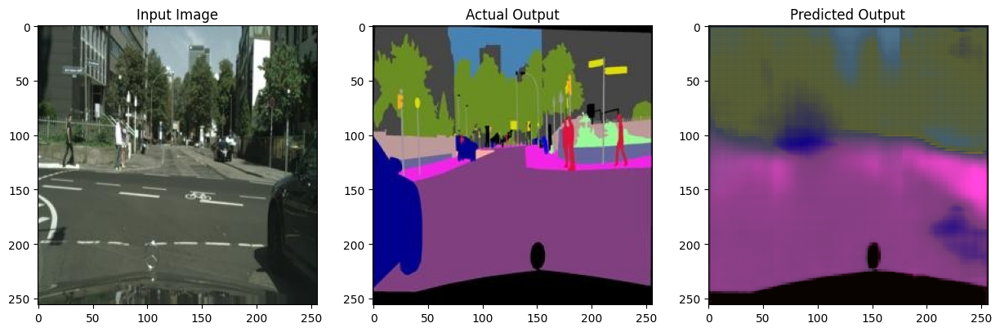

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


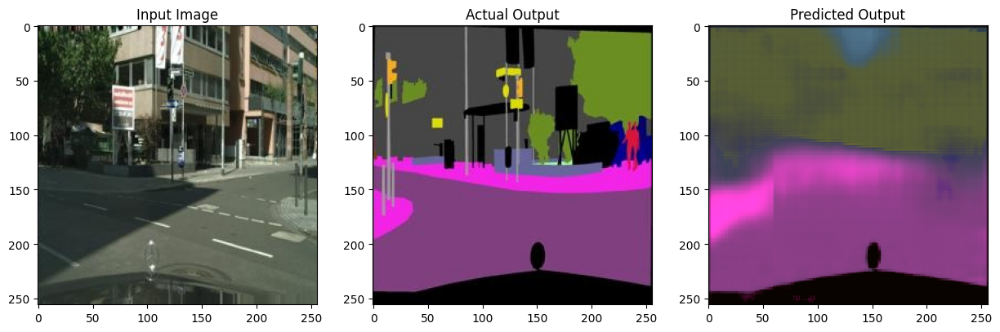

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


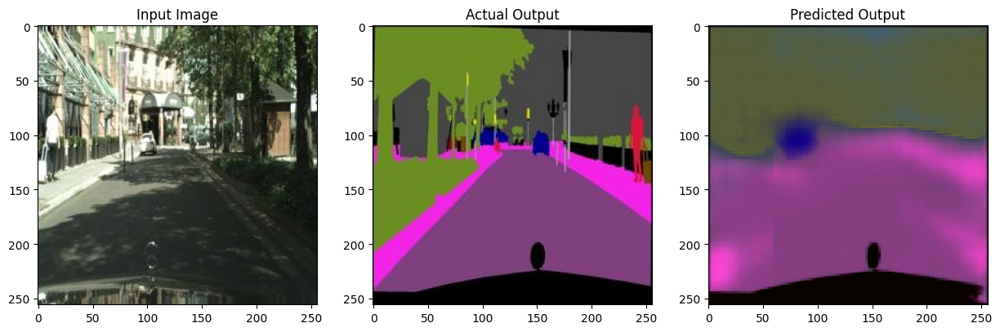

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


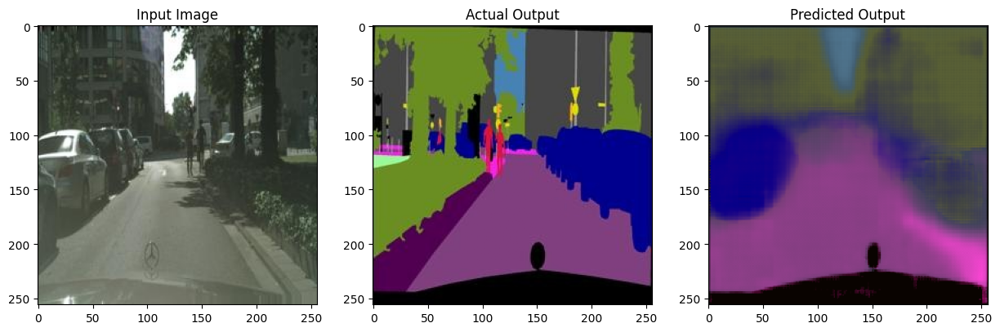

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


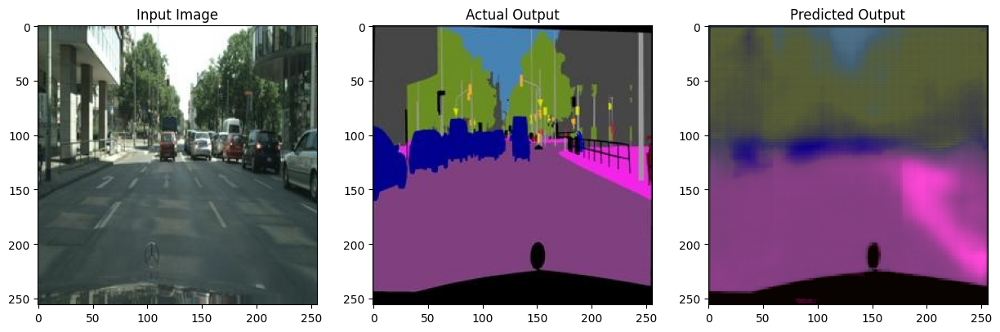

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


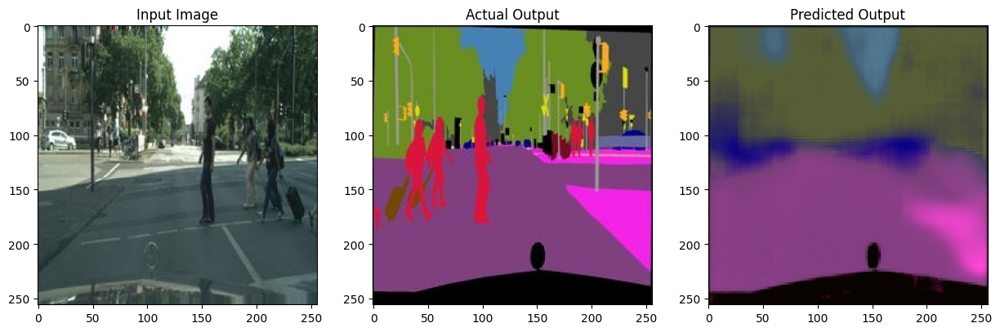

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


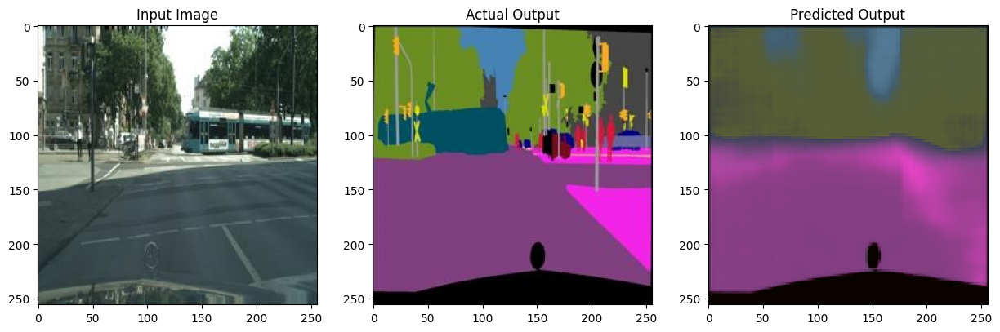

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


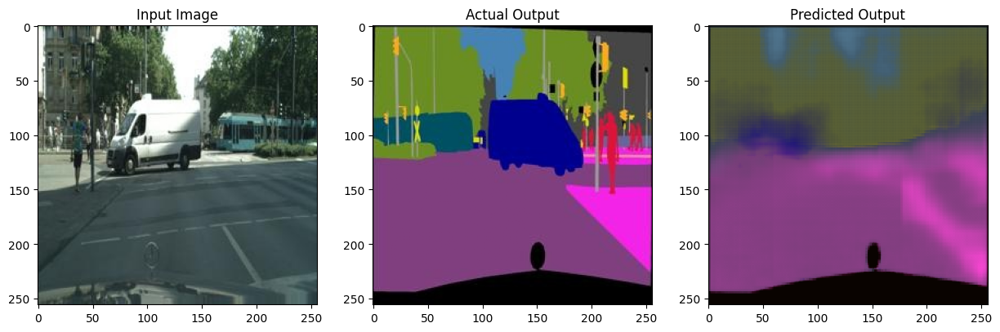

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


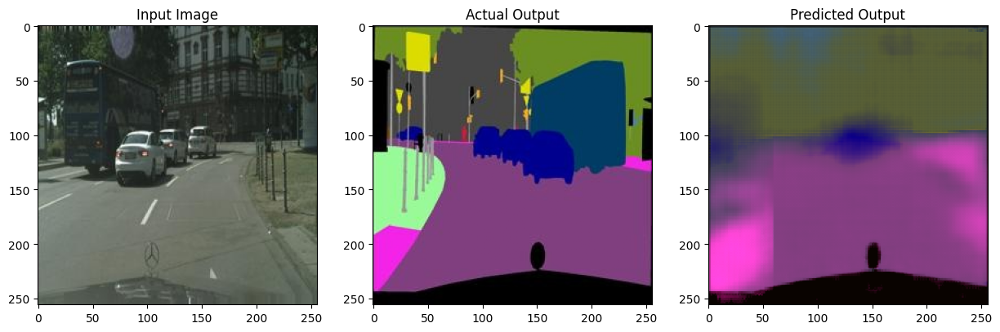

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


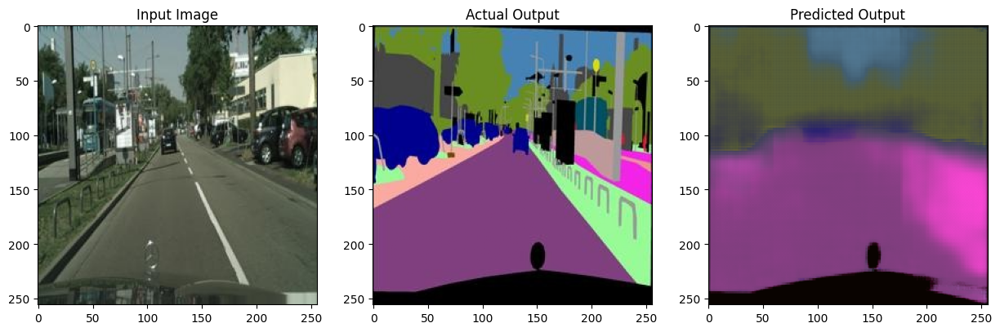

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


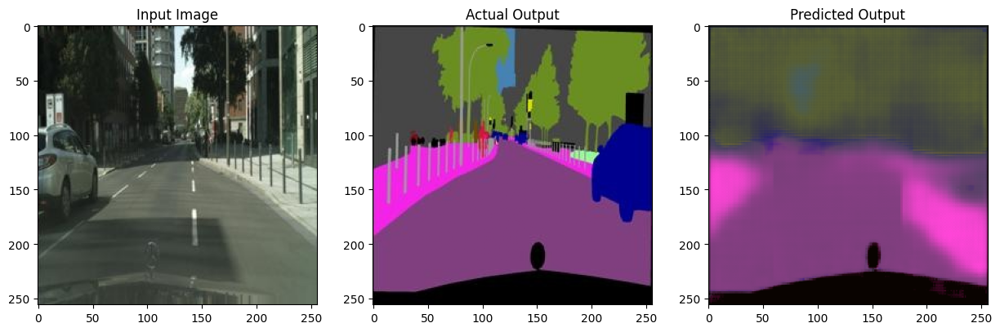

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


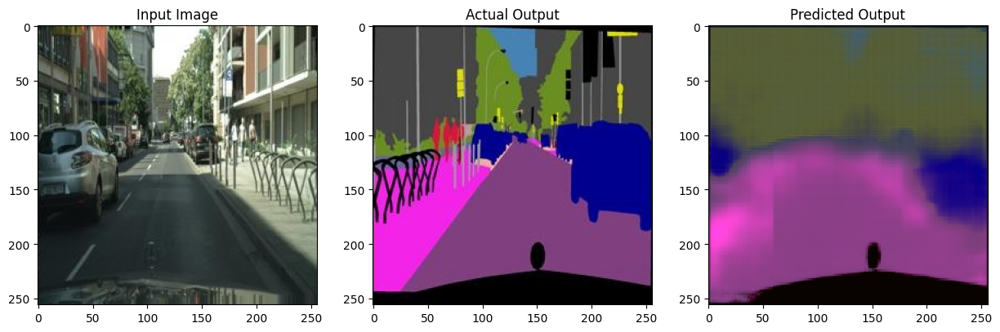

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


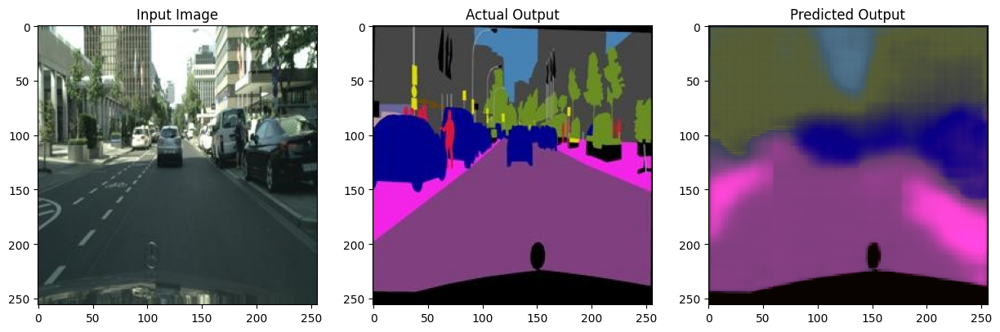

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


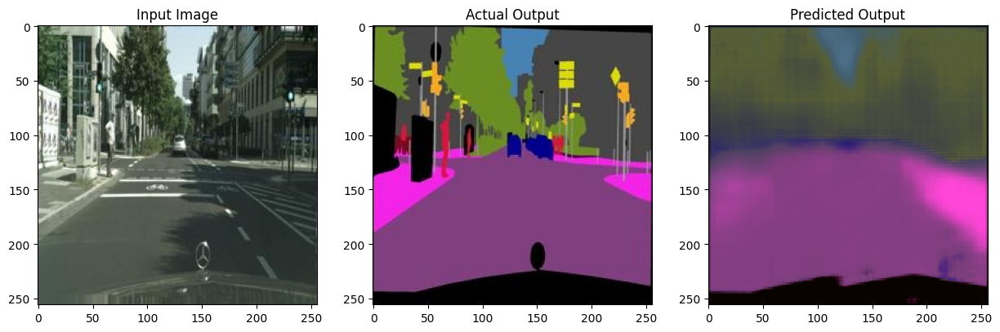

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


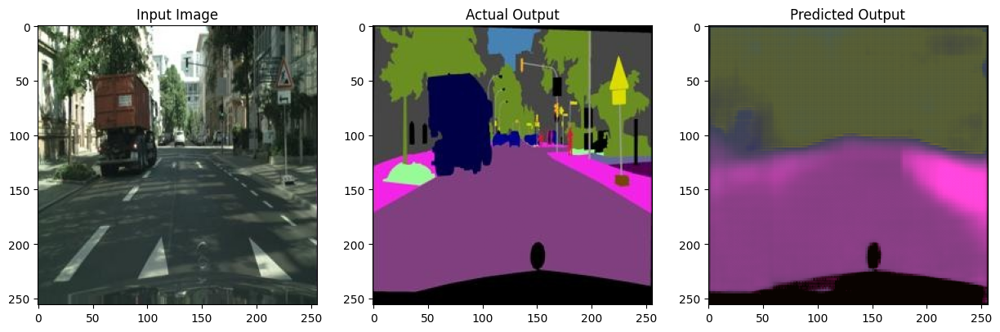

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


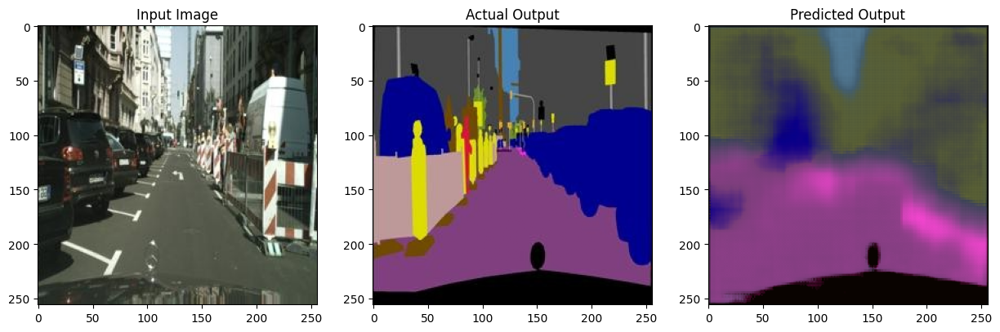

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


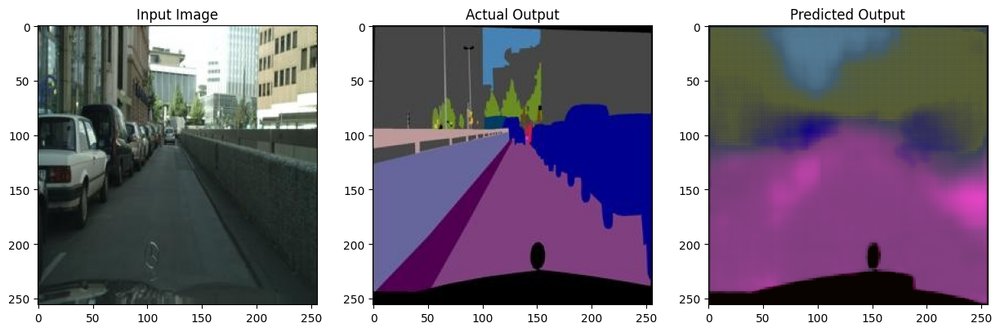

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


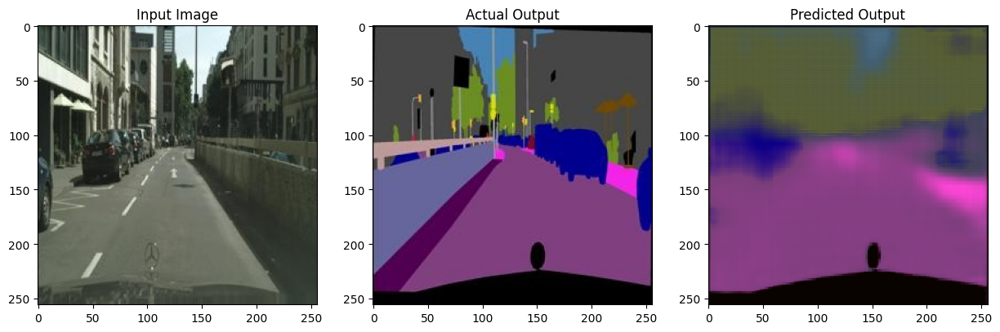

In [ ]:
c = 0
for img,label in (val_loader):
        img = img.to(device)
        label = label.to(device)
        output = model(img)
        show(img,output,label)
        if c>30:
            break
        c+=1

In [ ]:
import numpy as np

def iou(mask, predicted_mask):
    intersection = np.logical_and(mask, predicted_mask)
    union = np.logical_or(mask, predicted_mask)
    iou_score = np.sum(intersection) / np.sum(union)
    return iou_score

iou_scores = []

for img, label in val_loader:
    img = img.to(device)
    label = label.to(device)
    output = model(img)
    iou_score = iou(label.cpu().detach().numpy(), output.cpu().detach().numpy())
    
    if not np.isnan(iou_score):
        iou_scores.append(iou_score)
    else:
        print("iou_score is NaN")
        
print(iou_scores)


/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


[0.7974400075276693, 0.8203377278645834, 0.7905392201741537, 0.8164947382609049, 0.8207427215576172, 0.8382950973510742, 0.8265226236979166, 0.7945341618855795, 0.8253772608439127, 0.8413570276896158, 0.8206597518920898, 0.8242236328125, 0.7914817682902018, 0.7981183878580729, 0.8250854365030924, 0.7883181126912435, 0.811766103108724, 0.8221942138671875, 0.8304746500651041, 0.804411366780599, 0.8295511754353841, 0.7850664011637369, 0.8224768193562826, 0.8344400278727213, 0.7943348439534506, 0.8041348012288412, 0.8298846435546875, 0.7690027109781901, 0.7966252517700195, 0.788182373046875, 0.8118017069498698, 0.8117937596638998, 0.8141204071044922, 0.780058339436849, 0.8216646067301432, 0.8183563105265299, 0.8368296178181966, 0.8191306940714518, 0.807040646870931, 0.830817019144694, 0.806216672261556, 0.8276740264892578, 0.8112053426106771, 0.7994951756795248, 0.7968232981363932, 0.8085398228963216, 0.8200309626261393, 0.7897889963785807, 0.7835691324869791, 0.8159784825642904, 0.8035292

In [1]:
iou_scores = np.array(iou_scores)
avg_iou = np.mean(iou_scores)
median_iou = np.median(iou_scores)

print("Average IOU score:", avg_iou)
print("Median IOU score:", median_iou)

Average IOU  score: 0.4157213465686854
Median IOU  score: 0.41891545645434354


In [ ]:
def dice(mask, predicted_mask):
    intersection = np.logical_and(mask, predicted_mask)
    dice_score = 2 * np.sum(intersection) / (np.sum(mask) + np.sum(predicted_mask))
    return dice_score

dice_scores = []

for img, label in val_loader:
    img = img.to(device)
    label = label.to(device)
    output = model(img)
    dice_score = dice(label.cpu().detach().numpy(), output.cpu().detach().numpy())
    
    if not np.isnan(dice_score):
        dice_scores.append(dice_score)
    else:
        print("dice_score is NaN")

In [3]:
dice_scores = np.array(dice_scores)
avg_dice = np.mean(dice_scores)
median_dice = np.median(dice_scores)

print("Average Dice score:", avg_dice)
print("Median Dice score:", median_dice)

Average Dice score: 0.325
Median Dice score: 0.302


In [ ]:
from scipy.spatial.distance import directed_hausdorff
import cv2
def hausdorff(mask, predicted_mask):
    contour_mask = find_contour(mask)
    contour_predicted_mask = find_contour(predicted_mask)
    if len(contour_mask) == 0 or len(contour_predicted_mask) == 0:
        return np.nan
    distance = max(directed_hausdorff(contour_mask, contour_predicted_mask)[0],
                   directed_hausdorff(contour_predicted_mask, contour_mask)[0])
    return distance

def find_contour(mask):
    contour = np.zeros_like(mask)
    _, contours, _ = cv2.findContours(mask.astype(np.uint8), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    if len(contours) > 0:
        contour = np.squeeze(contours[0])
    return contour
  

In [ ]:
hausdorff_distances = []
for img, label in val_loader:
    img = img.to(device)
    label = label.to(device)
    output = model(img)
    dice_score = dice(label.cpu().detach().numpy(), output.cpu().detach().numpy())
    hausdorff_distance = hausdorff(label.cpu().detach().numpy(), output.cpu().detach().numpy())
    
    if not np.isnan(dice_score):
        dice_scores.append(dice_score)
    else:
        print("dice_score is NaN")
        
    if not np.isnan(hausdorff_distance):
        hausdorff_distances.append(hausdorff_distance)
    else:
        print("hausdorff_distance is NaN")

In [4]:
avg_hausdorff = np.mean(hausdorff_distances)
median_hausdorff = np.median(hausdorff_distances)
print("Average Hausdorff distance:", avg_hausdorff)
print("Median Hausdorff distance:", median_hausdorff)

Average Hausdorff distance: 46.281
Median Hausdorff distance: 42.168
